In [206]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px

In [207]:
data = pd.read_csv('C:/Users/david/Downloads/train.csv.zip')  
print(data.columns.tolist())

['stock_id', 'date_id', 'seconds_in_bucket', 'imbalance_size', 'imbalance_buy_sell_flag', 'reference_price', 'matched_size', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price', 'ask_size', 'wap', 'target', 'time_id', 'row_id']


In [208]:
print(data.head(3))
data.info()
data.describe()
print(data.isnull().sum())

   stock_id  date_id  seconds_in_bucket  imbalance_size  \
0         0        0                  0      3180602.69   
1         1        0                  0       166603.91   
2         2        0                  0       302879.87   

   imbalance_buy_sell_flag  reference_price  matched_size  far_price  \
0                        1         0.999812   13380276.64        NaN   
1                       -1         0.999896    1642214.25        NaN   
2                       -1         0.999561    1819368.03        NaN   

   near_price  bid_price  bid_size  ask_price  ask_size  wap    target  \
0         NaN   0.999812  60651.50   1.000026   8493.03  1.0 -3.029704   
1         NaN   0.999896   3233.04   1.000660  20605.09  1.0 -5.519986   
2         NaN   0.999403  37956.00   1.000298  18995.00  1.0 -8.389950   

   time_id row_id  
0        0  0_0_0  
1        0  0_0_1  
2        0  0_0_2  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5237980 entries, 0 to 5237979
Data columns (tot

In [209]:
cols_ffill = ["reference_price","matched_size","bid_price","ask_price","wap",
              "near_price","far_price"]  # ffill only within each day/stock
df = data.sort_values(["stock_id","date_id","seconds_in_bucket"])

# Flags before fill
df["has_near"] = df["near_price"].notna().astype("int8")
df["has_far"]  = df["far_price"].notna().astype("int8")

# Forward fill within (stock, day)
df[cols_ffill] = (df
  .groupby(["stock_id","date_id"], as_index=False)[cols_ffill]
  .apply(lambda g: g.ffill())
  .reset_index(level=[0,1], drop=True))

In [210]:
df[cols_ffill] = df.groupby(["stock_id","date_id", "seconds_in_bucket"])[cols_ffill].ffill().bfill()
print(df.isnull().sum())

stock_id                     0
date_id                      0
seconds_in_bucket            0
imbalance_size             220
imbalance_buy_sell_flag      0
reference_price              0
matched_size                 0
far_price                    0
near_price                   0
bid_price                    0
bid_size                     0
ask_price                    0
ask_size                     0
wap                          0
target                      88
time_id                      0
row_id                       0
has_near                     0
has_far                      0
dtype: int64


In [211]:
df = df.dropna(subset=["target"])
print(df.isnull().sum())

stock_id                     0
date_id                      0
seconds_in_bucket            0
imbalance_size             132
imbalance_buy_sell_flag      0
reference_price              0
matched_size                 0
far_price                    0
near_price                   0
bid_price                    0
bid_size                     0
ask_price                    0
ask_size                     0
wap                          0
target                       0
time_id                      0
row_id                       0
has_near                     0
has_far                      0
dtype: int64


In [212]:
# Remove leading/trailing spaces and replace placeholders
df["imbalance_size"] = df["imbalance_size"].astype(str).str.strip()
df["imbalance_size"].replace(["NA", "", "nan"], np.nan, inplace=True)

# Convert to numeric
df["imbalance_size"] = pd.to_numeric(df["imbalance_size"], errors='coerce')

# Flag before fill
df["has_imbalance"] = df["imbalance_size"].notna().astype("int8")

# Forward fill within stock/day
df["imbalance_size"] = (
    df.groupby(["stock_id","date_id"])["imbalance_size"].ffill().bfill()
)

C:\Users\david\AppData\Local\Temp\ipykernel_7536\2163599148.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["imbalance_size"].replace(["NA", "", "nan"], np.nan, inplace=True)


In [213]:
print(df.columns.tolist())
df.info()
df.describe()
print(df.isnull().sum())

['stock_id', 'date_id', 'seconds_in_bucket', 'imbalance_size', 'imbalance_buy_sell_flag', 'reference_price', 'matched_size', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price', 'ask_size', 'wap', 'target', 'time_id', 'row_id', 'has_near', 'has_far', 'has_imbalance']
<class 'pandas.core.frame.DataFrame'>
Index: 5237892 entries, 0 to 5237979
Data columns (total 20 columns):
 #   Column                   Dtype  
---  ------                   -----  
 0   stock_id                 int64  
 1   date_id                  int64  
 2   seconds_in_bucket        int64  
 3   imbalance_size           float64
 4   imbalance_buy_sell_flag  int64  
 5   reference_price          float64
 6   matched_size             float64
 7   far_price                float64
 8   near_price               float64
 9   bid_price                float64
 10  bid_size                 float64
 11  ask_price                float64
 12  ask_size                 float64
 13  wap                      float64
 14 

In [214]:
# Engineered features
df["near_minus_wap"] = df["near_price"] - df["wap"]
df["far_minus_wap"]  = df["far_price"] - df["wap"]
df["near_minus_far"] = df["near_price"] - df["far_price"]
df["bid_ask_spread"] = df["ask_price"] - df["bid_price"]
df["midprice"]       = (df["ask_price"] + df["bid_price"]) / 2
df["wap_dev_mid"]    = df["wap"] - df["midprice"]
df["signed_imbalance"] = df["imbalance_size"] * (2*(df["imbalance_buy_sell_flag"] == 1) - 1)
df["imbalance_ratio"] = df["imbalance_size"] / (df["matched_size"] + 1e-6)

# time left in auction
df["seconds_remaining"] = 599 - df["seconds_in_bucket"]

# lag to capture trends over last 1–6 seconds
for c in ["wap","near_price","far_price","signed_imbalance","bid_ask_spread"]:
    for k in [1,3,6]:  # 1-sec, 3-sec, 6-sec lags
        df[f"{c}_lag{k}"] = df.groupby(["stock_id","date_id"])[c].shift(k)
        df[f"{c}_chg{k}"] = df[c] - df[f"{c}_lag{k}"]

In [215]:
print(df.columns.tolist())

['stock_id', 'date_id', 'seconds_in_bucket', 'imbalance_size', 'imbalance_buy_sell_flag', 'reference_price', 'matched_size', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price', 'ask_size', 'wap', 'target', 'time_id', 'row_id', 'has_near', 'has_far', 'has_imbalance', 'near_minus_wap', 'far_minus_wap', 'near_minus_far', 'bid_ask_spread', 'midprice', 'wap_dev_mid', 'signed_imbalance', 'imbalance_ratio', 'seconds_remaining', 'wap_lag1', 'wap_chg1', 'wap_lag3', 'wap_chg3', 'wap_lag6', 'wap_chg6', 'near_price_lag1', 'near_price_chg1', 'near_price_lag3', 'near_price_chg3', 'near_price_lag6', 'near_price_chg6', 'far_price_lag1', 'far_price_chg1', 'far_price_lag3', 'far_price_chg3', 'far_price_lag6', 'far_price_chg6', 'signed_imbalance_lag1', 'signed_imbalance_chg1', 'signed_imbalance_lag3', 'signed_imbalance_chg3', 'signed_imbalance_lag6', 'signed_imbalance_chg6', 'bid_ask_spread_lag1', 'bid_ask_spread_chg1', 'bid_ask_spread_lag3', 'bid_ask_spread_chg3', 'bid_ask_spread_lag6', 'bi

In [216]:
df['wap_ma3'] = df.groupby(['stock_id','date_id'])['wap'].rolling(window=3).mean().reset_index(level=[0,1], drop=True)
df['wap_std6'] = df.groupby(['stock_id','date_id'])['wap'].rolling(window=6).std().reset_index(level=[0,1], drop=True)

delta = df.groupby(['stock_id','date_id'])['wap'].diff()
gain = delta.clip(lower=0)
loss = -delta.clip(upper=0)

roll_up = gain.groupby([df.stock_id, df.date_id]).rolling(window=6, min_periods=1).mean().reset_index(level=[0,1], drop=True)
roll_down = loss.groupby([df.stock_id, df.date_id]).rolling(window=6, min_periods=1).mean().reset_index(level=[0,1], drop=True)

df['wap_RSI'] = 100 - (100 / (1 + roll_up / (roll_down + 1e-6))) # 1e-6 for nonzero denomantor

In [217]:
df_final = df.copy()
print(df_final.columns.tolist())

['stock_id', 'date_id', 'seconds_in_bucket', 'imbalance_size', 'imbalance_buy_sell_flag', 'reference_price', 'matched_size', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price', 'ask_size', 'wap', 'target', 'time_id', 'row_id', 'has_near', 'has_far', 'has_imbalance', 'near_minus_wap', 'far_minus_wap', 'near_minus_far', 'bid_ask_spread', 'midprice', 'wap_dev_mid', 'signed_imbalance', 'imbalance_ratio', 'seconds_remaining', 'wap_lag1', 'wap_chg1', 'wap_lag3', 'wap_chg3', 'wap_lag6', 'wap_chg6', 'near_price_lag1', 'near_price_chg1', 'near_price_lag3', 'near_price_chg3', 'near_price_lag6', 'near_price_chg6', 'far_price_lag1', 'far_price_chg1', 'far_price_lag3', 'far_price_chg3', 'far_price_lag6', 'far_price_chg6', 'signed_imbalance_lag1', 'signed_imbalance_chg1', 'signed_imbalance_lag3', 'signed_imbalance_chg3', 'signed_imbalance_lag6', 'signed_imbalance_chg6', 'bid_ask_spread_lag1', 'bid_ask_spread_chg1', 'bid_ask_spread_lag3', 'bid_ask_spread_chg3', 'bid_ask_spread_lag6', 'bi

In [218]:
df_final['wap'].describe()

count    5.237892e+06
mean     9.999920e-01
std      2.497515e-03
min      9.380080e-01
25%      9.987810e-01
50%      9.999970e-01
75%      1.001149e+00
max      1.077675e+00
Name: wap, dtype: float64

In [219]:
print(df_final['stock_id'].nunique())
print(df_final['date_id'].nunique())

200
481


In [220]:
print("Skewness of Adj Close:", df_final['wap'].skew())
print("Kurtosis of Adj Close:", df_final['wap'].kurt())

Skewness of Adj Close: 0.3755708316147052
Kurtosis of Adj Close: 10.885921223421297


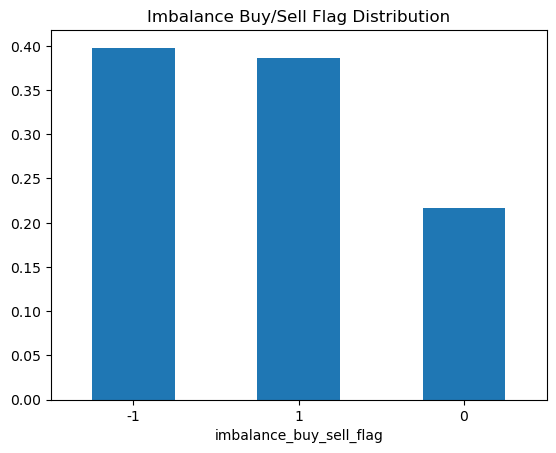

In [221]:
df_final['imbalance_buy_sell_flag'].value_counts(normalize=True).plot(kind='bar')
plt.title("Imbalance Buy/Sell Flag Distribution")
plt.xticks(rotation=0)
plt.show()

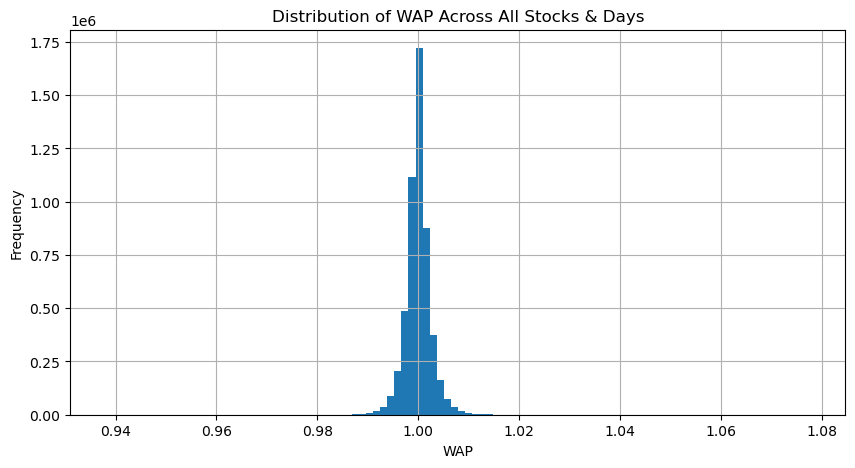

In [222]:
plt.figure(figsize=(10,5))
df_final["wap"].hist(bins=100)
plt.title("Distribution of WAP Across All Stocks & Days")
plt.xlabel("WAP")
plt.ylabel("Frequency")
plt.show()

In [223]:
df_final["log_return"] = np.log(df_final["wap"]) - np.log(df_final["wap"].shift(1))
log_return = df_final["log_return"].dropna()

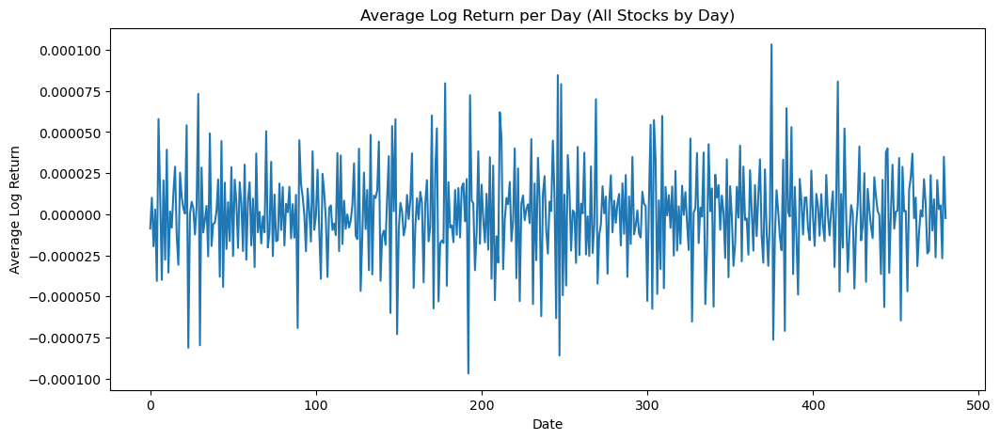

In [224]:
daily_wap = df_final.groupby("date_id")["log_return"].mean()

plt.figure(figsize=(12,5))
daily_wap.plot()
plt.title("Average Log Return per Day (All Stocks by Day)")
plt.xlabel("Date")
plt.ylabel("Average Log Return")
plt.show()

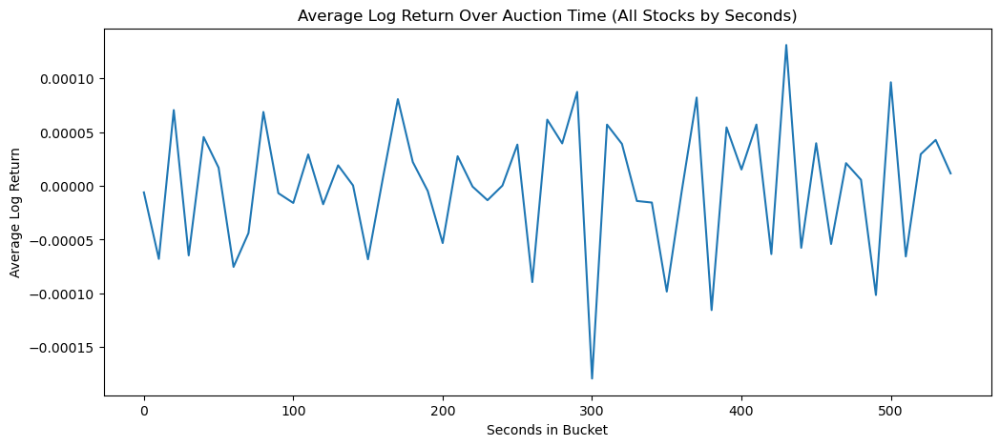

In [225]:
import seaborn as sns

# average across stocks at each second
avg_wap_by_time = df_final.groupby("seconds_in_bucket")["log_return"].mean().reset_index()

plt.figure(figsize=(12,5))
sns.lineplot(data=avg_wap_by_time, x="seconds_in_bucket", y="log_return")
plt.title("Average Log Return Over Auction Time (All Stocks by Seconds)")
plt.xlabel("Seconds in Bucket")
plt.ylabel("Average Log Return")
plt.show()

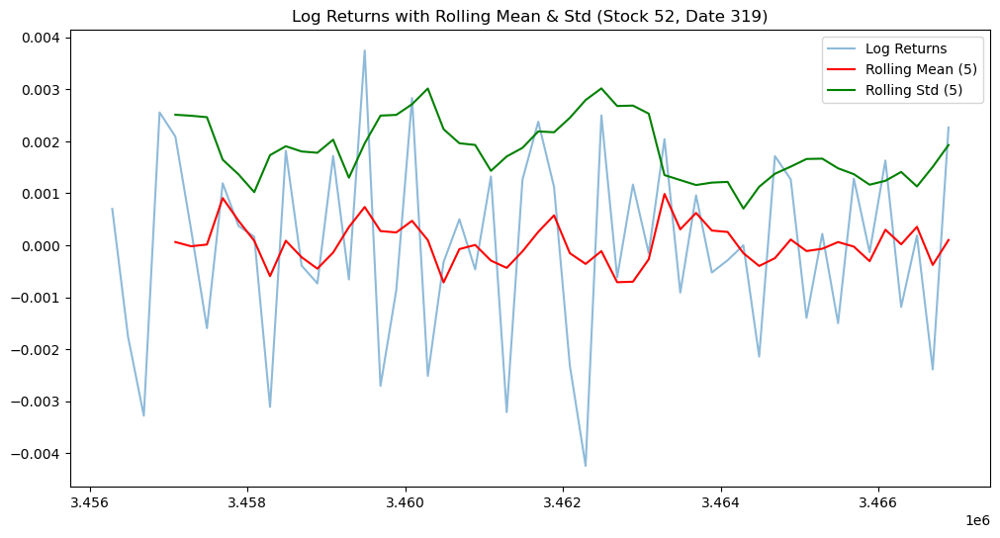

<Figure size 1200x400 with 0 Axes>

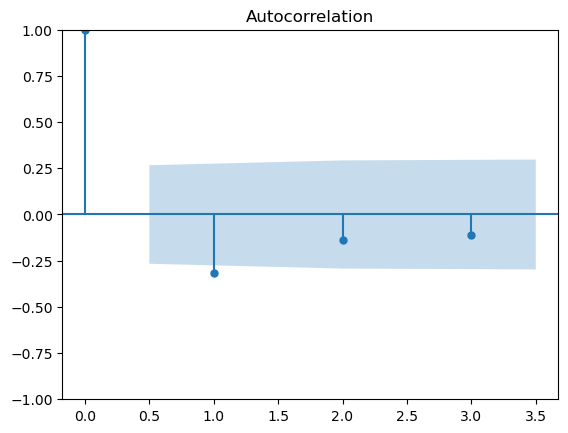

<Figure size 1200x400 with 0 Axes>

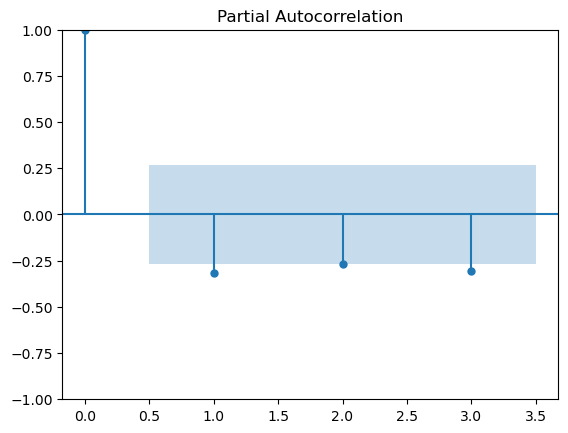

In [226]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
n_stocks = 10
n_days = 10
def stationarity_diagnostics(df_final, n_stocks = 10, n_days = 10, window=5, seed=42): np.random.seed(seed)

# pick one stock and one day
stocks = np.random.choice(df_final["stock_id"].unique(), size = n_stocks, replace=False)
dates = np.random.choice(df_final["date_id"].unique(), size = n_days, replace=False)


for stock_id in stocks:
        for date_id in dates:
            df_subset = df_final[(df_final["stock_id"] == stock_id) & (df_final["date_id"] == date_id)].copy()
            df_subset = df_subset.sort_values("seconds_in_bucket")

# compute log returns
df_subset["log_return"] = np.log(df_subset["wap"]) - np.log(df_subset["wap"].shift(1))
returns = df_subset["log_return"].dropna()

# --- Rolling Mean & Std ---
rolling_mean = returns.rolling(window=5).mean()
rolling_std = returns.rolling(window=5).std()

plt.figure(figsize=(12,6))
plt.plot(returns, label="Log Returns", alpha=0.5)
plt.plot(rolling_mean, label="Rolling Mean (5)", color="red")
plt.plot(rolling_std, label="Rolling Std (5)", color="green")
plt.title(f"Log Returns with Rolling Mean & Std (Stock {stock_id}, Date {date_id})")
plt.legend()
plt.show()

# --- Autocorrelation & Partial Autocorrelation ---
plt.figure(figsize=(12,4))
plot_acf(returns.dropna(), lags=3)
plt.show()

plt.figure(figsize=(12,4))
plot_pacf(returns.dropna(), lags=3)
plt.show()                       

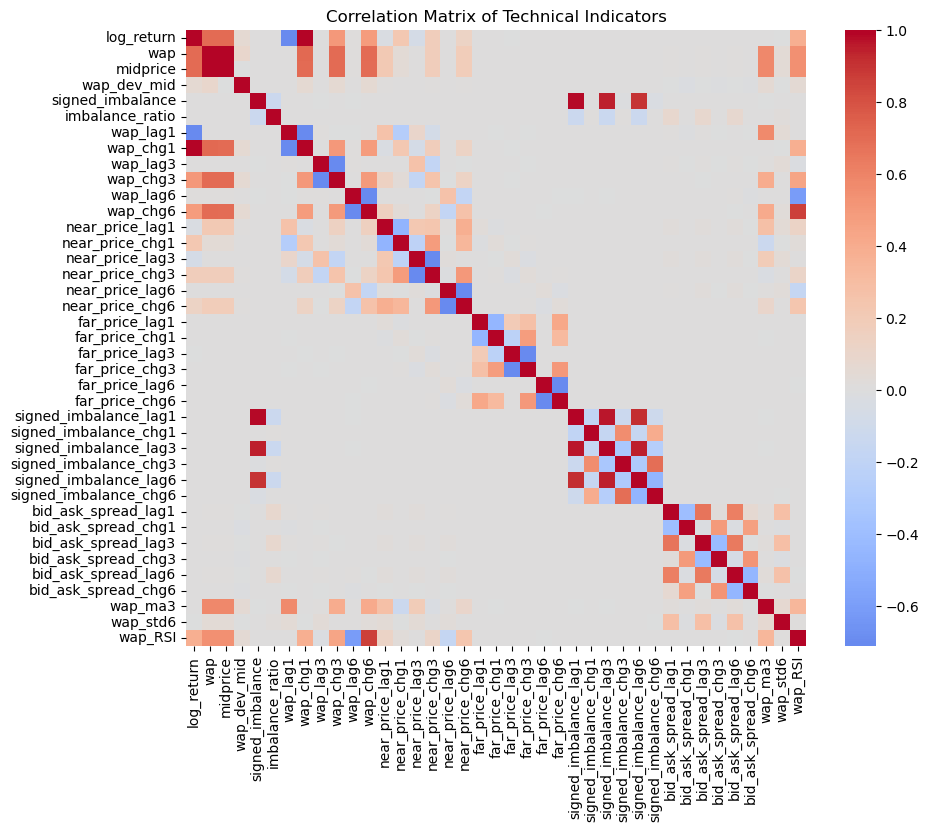

In [227]:
df_final["log_return"] = np.log(df_final["wap"]) - np.log(df_final["wap"].shift(1))

indicators = [
    "log_return", "wap", "midprice", "wap_dev_mid", "signed_imbalance", 
    "imbalance_ratio", "wap_lag1", "wap_chg1", "wap_lag3", "wap_chg3", 
    "wap_lag6", "wap_chg6", "near_price_lag1", "near_price_chg1", 
    "near_price_lag3", "near_price_chg3", "near_price_lag6", 
    "near_price_chg6", "far_price_lag1", "far_price_chg1", 
    "far_price_lag3", "far_price_chg3", "far_price_lag6", 
    "far_price_chg6", "signed_imbalance_lag1", "signed_imbalance_chg1", 
    "signed_imbalance_lag3", "signed_imbalance_chg3", "signed_imbalance_lag6",
    "signed_imbalance_chg6", "bid_ask_spread_lag1", "bid_ask_spread_chg1",
    "bid_ask_spread_lag3", "bid_ask_spread_chg3", "bid_ask_spread_lag6", 
    "bid_ask_spread_chg6", "wap_ma3", "wap_std6", "wap_RSI"
]

corr_matrix = df_final[indicators].corr()

plt.figure(figsize=(10,8))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0, fmt=".2f")
plt.title("Correlation Matrix of Technical Indicators")
plt.show()

In [228]:
z_score = ((df_final['log_return'] - df_final['log_return'].mean()) / df_final['log_return'].std())
threshhold = 3
extreme_values = df_final[np.abs(z_score) > threshhold]
print(extreme_values[['log_return']])

         log_return
38773      0.011653
38964     -0.014322
43364      0.011545
47204      0.011056
58724      0.011946
...             ...
5015979   -0.013297
5016779   -0.010900
5066379    0.015219
5066579   -0.017439
5101779    0.012565

[63284 rows x 1 columns]


In [229]:
df_sample = df_final[indicators].sample(5000, random_state=42)  # 5k rows
sns.pairplot(df_sample, diag_kind="kde", plot_kws={"alpha":0.3})
plt.figure(figsize=(10,8))
plt.suptitle("Pairwise Relationships of Technical Indicators (sample)", y=1.02)
plt.show()

<Figure size 1000x800 with 0 Axes>

In [230]:
print(df_final.columns.tolist())
print(df_final["log_return"].dtype)

['stock_id', 'date_id', 'seconds_in_bucket', 'imbalance_size', 'imbalance_buy_sell_flag', 'reference_price', 'matched_size', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price', 'ask_size', 'wap', 'target', 'time_id', 'row_id', 'has_near', 'has_far', 'has_imbalance', 'near_minus_wap', 'far_minus_wap', 'near_minus_far', 'bid_ask_spread', 'midprice', 'wap_dev_mid', 'signed_imbalance', 'imbalance_ratio', 'seconds_remaining', 'wap_lag1', 'wap_chg1', 'wap_lag3', 'wap_chg3', 'wap_lag6', 'wap_chg6', 'near_price_lag1', 'near_price_chg1', 'near_price_lag3', 'near_price_chg3', 'near_price_lag6', 'near_price_chg6', 'far_price_lag1', 'far_price_chg1', 'far_price_lag3', 'far_price_chg3', 'far_price_lag6', 'far_price_chg6', 'signed_imbalance_lag1', 'signed_imbalance_chg1', 'signed_imbalance_lag3', 'signed_imbalance_chg3', 'signed_imbalance_lag6', 'signed_imbalance_chg6', 'bid_ask_spread_lag1', 'bid_ask_spread_chg1', 'bid_ask_spread_lag3', 'bid_ask_spread_chg3', 'bid_ask_spread_lag6', 'bi

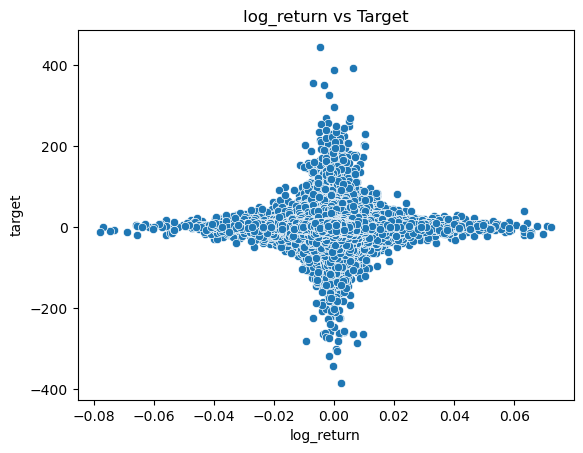

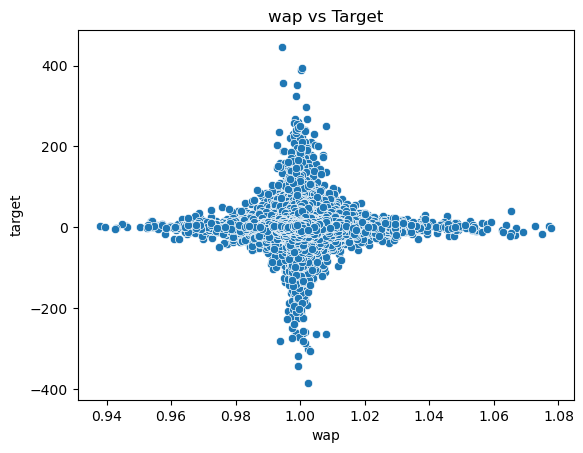

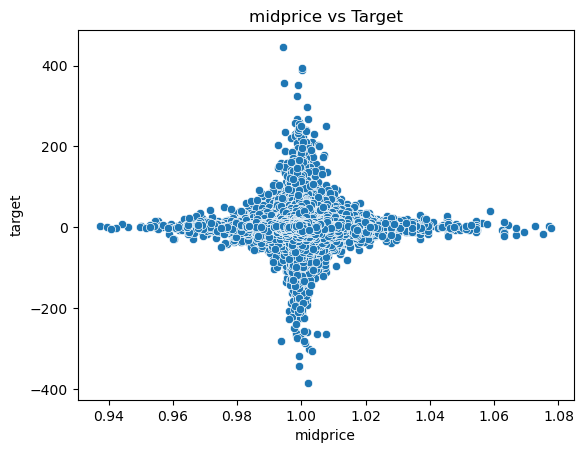

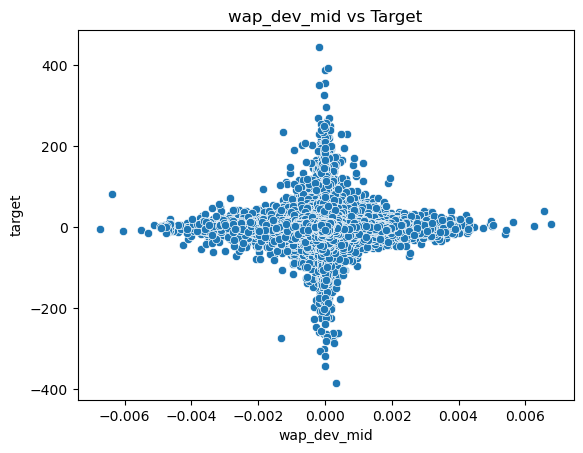

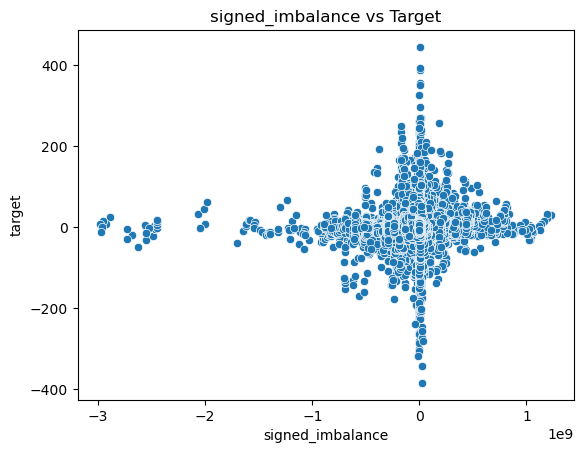

...

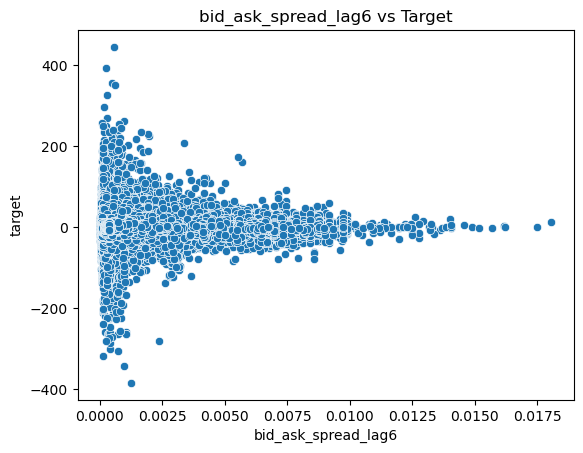

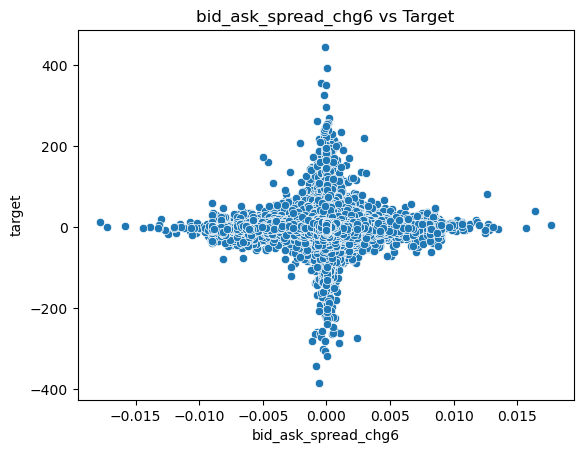

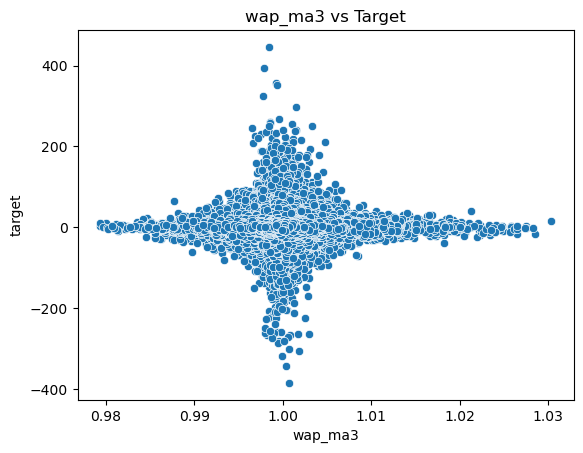

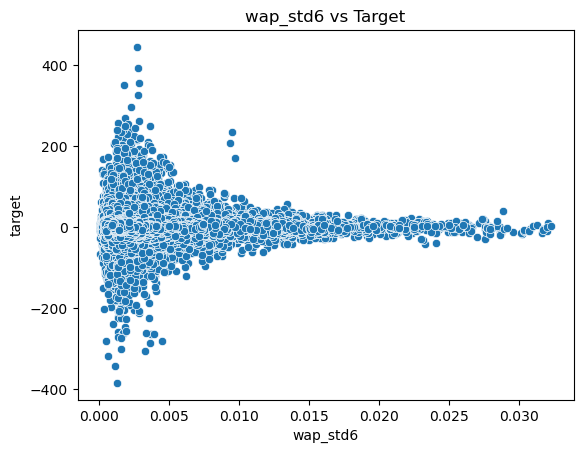

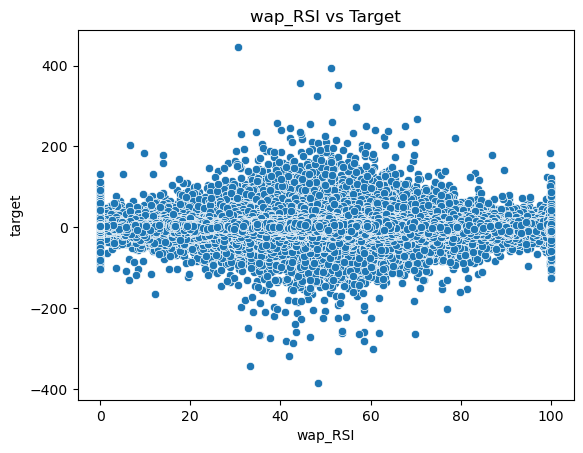

In [231]:
for col in indicators:
    sns.scatterplot(x=df_final[col], y=df_final['target'])
    plt.title(f'{col} vs Target')
    plt.show()

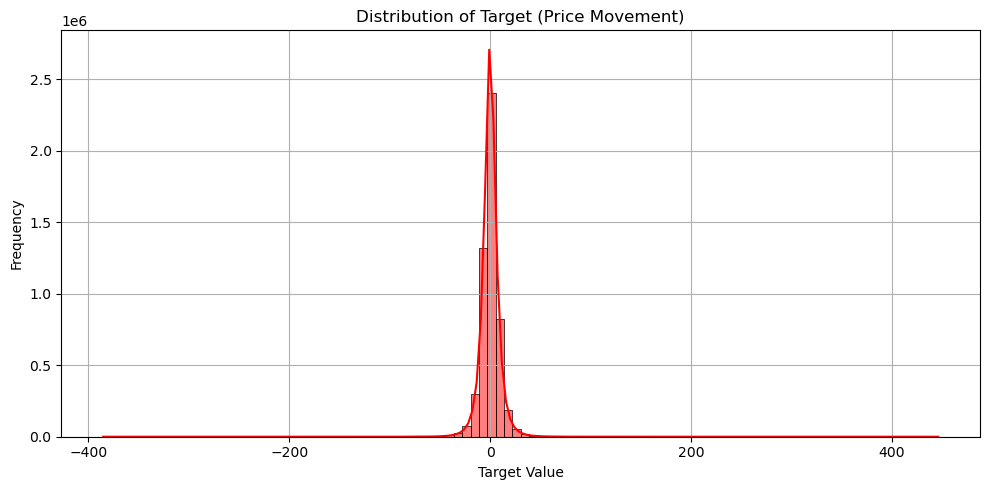

In [232]:
plt.figure(figsize=(10, 5))
sns.histplot(df_final['target'], bins=100, kde=True, color='red')
plt.title('Distribution of Target (Price Movement)')
plt.xlabel('Target Value')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout()
plt.show()

In [233]:
df_final['target'].describe()

count    5.237892e+06
mean    -4.756125e-02
std      9.452860e+00
min     -3.852898e+02
25%     -4.559755e+00
50%     -6.020069e-02
75%      4.409552e+00
max      4.460704e+02
Name: target, dtype: float64

In [234]:
lags = [1,2,3]
for lag in lags:
    df_final[f"log_return_lag{lag}"] = df_final.groupby(["stock_id","date_id"])["log_return"].shift(lag)
df_final = df_final.dropna(subset=[f"log_return_lag{lag}" for lag in lags])
print(df_final.columns.tolist())

['stock_id', 'date_id', 'seconds_in_bucket', 'imbalance_size', 'imbalance_buy_sell_flag', 'reference_price', 'matched_size', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price', 'ask_size', 'wap', 'target', 'time_id', 'row_id', 'has_near', 'has_far', 'has_imbalance', 'near_minus_wap', 'far_minus_wap', 'near_minus_far', 'bid_ask_spread', 'midprice', 'wap_dev_mid', 'signed_imbalance', 'imbalance_ratio', 'seconds_remaining', 'wap_lag1', 'wap_chg1', 'wap_lag3', 'wap_chg3', 'wap_lag6', 'wap_chg6', 'near_price_lag1', 'near_price_chg1', 'near_price_lag3', 'near_price_chg3', 'near_price_lag6', 'near_price_chg6', 'far_price_lag1', 'far_price_chg1', 'far_price_lag3', 'far_price_chg3', 'far_price_lag6', 'far_price_chg6', 'signed_imbalance_lag1', 'signed_imbalance_chg1', 'signed_imbalance_lag3', 'signed_imbalance_chg3', 'signed_imbalance_lag6', 'signed_imbalance_chg6', 'bid_ask_spread_lag1', 'bid_ask_spread_chg1', 'bid_ask_spread_lag3', 'bid_ask_spread_chg3', 'bid_ask_spread_lag6', 'bi

In [235]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error
%pip install xgboost
import xgboost as xgb
from xgboost.callback import EarlyStopping

feature_cols = [
    "log_return", "wap", "midprice", "wap_dev_mid", "signed_imbalance", 
    "imbalance_ratio", "wap_lag1", "wap_chg1", "wap_lag3", "wap_chg3", 
    "wap_lag6", "wap_chg6", "near_price_lag1", "near_price_chg1", 
    "near_price_lag3", "near_price_chg3", "near_price_lag6", 
    "near_price_chg6", "far_price_lag1", "far_price_chg1", 
    "far_price_lag3", "far_price_chg3", "far_price_lag6", 
    "far_price_chg6", "signed_imbalance_lag1", "signed_imbalance_chg1", 
    "signed_imbalance_lag3", "signed_imbalance_chg3", "signed_imbalance_lag6",
    "signed_imbalance_chg6", "bid_ask_spread_lag1", "bid_ask_spread_chg1",
    "bid_ask_spread_lag3", "bid_ask_spread_chg3", "bid_ask_spread_lag6", 
    "bid_ask_spread_chg6", "wap_ma3", "wap_std6", "wap_RSI",
    "log_return_lag1", "log_return_lag2", "log_return_lag3"
]

X = df_final[feature_cols]
y = df_final['target']   


X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, test_size=0.3, shuffle=False  # 70% train, 30% temp
)

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, shuffle=False)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)

# XGBoost model for noisy data
xgb_model = xgb.XGBRegressor(
    n_estimators=3000,
    max_depth=3,
    learning_rate=0.001,
    early_stopping_rounds=10,
    subsample=0.7,
    colsample_bytree=0.7,
    min_child_weight=10,
    gamma=2,
    reg_alpha=1,
    reg_lambda=3,
    objective='reg:squarederror',
    eval_metric='mae',
    random_state=42,
    n_jobs=-1
)

xgb_model.fit(
    X_train, y_train, 
    eval_set=[(X_val, y_val)],
    verbose=100
)

# Predict
y_pred = xgb_model.predict(X_test)

# Evaluate
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
print("XGBoost MAE:", mae)
print("XGBoost MSE:", mse)
print("XGBoost RMSE:", rmse)

Note: you may need to restart the kernel to use updated packages.
[0]	validation_0-mae:6.01191
[100]	validation_0-mae:6.01063
[200]	validation_0-mae:6.00957
[300]	validation_0-mae:6.00866
[400]	validation_0-mae:6.00790
[500]	validation_0-mae:6.00726
[600]	validation_0-mae:6.00673
[700]	validation_0-mae:6.00628
[800]	validation_0-mae:6.00591
[900]	validation_0-mae:6.00561
[1000]	validation_0-mae:6.00535
[1100]	validation_0-mae:6.00514
[1200]	validation_0-mae:6.00497
[1300]	validation_0-mae:6.00483
[1400]	validation_0-mae:6.00472
[1500]	validation_0-mae:6.00463
[1600]	validation_0-mae:6.00457
[1700]	validation_0-mae:6.00452
[1800]	validation_0-mae:6.00448
[1900]	validation_0-mae:6.00445
[2000]	validation_0-mae:6.00444
[2024]	validation_0-mae:6.00443
XGBoost MAE: 6.253022480677079
XGBoost MSE: 83.06397004667488
XGBoost RMSE: 9.113943715355877


In [236]:
# Predictions
y_pred = xgb_model.predict(X_test)
y_true = y_test.to_numpy()  # ensure numpy array

# Directional accuracy (up/down correct)
direction_true = np.sign(y_true)
direction_pred = np.sign(y_pred)
directional_accuracy = np.mean(direction_true == direction_pred)

# Correlation
correlation = np.corrcoef(y_true, y_pred)[0, 1]

print(f"Directional Accuracy: {directional_accuracy*100:.2f}%")
print(f"Correlation between predicted and actual: {correlation:.4f}")

Directional Accuracy: 51.82%
Correlation between predicted and actual: 0.0498


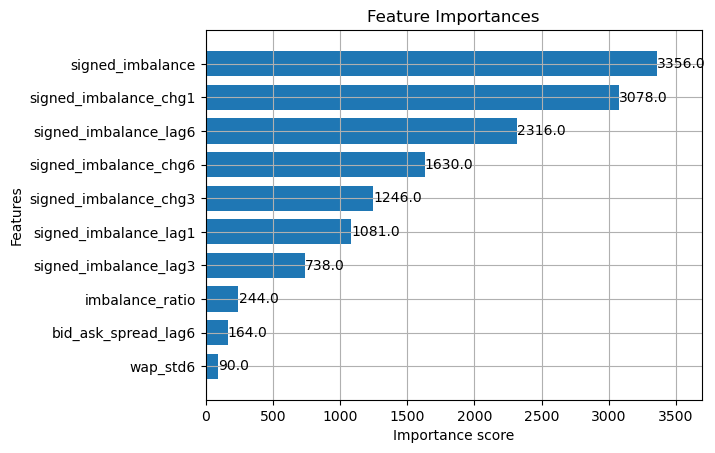

In [237]:
xgb.plot_importance(xgb_model, max_num_features=10, height=0.75)
plt.title("Feature Importances")
plt.show()

In [238]:
import statsmodels.api as sm

# Define X and y
X = df_final[['log_return_lag1','log_return_lag2','log_return_lag3', 'wap_ma3', 
              'wap_std6', 'wap_RSI', 'wap', 'signed_imbalance', 'imbalance_ratio']]
y = df_final['target']

# Train/test split
train_size = int(len(X) * 0.8)
X_train, X_test = X.iloc[:train_size], X.iloc[train_size:]
y_train, y_test = y.iloc[:train_size], y.iloc[train_size:]

X_train = X_train.dropna()
y_train = y_train.loc[X_train.index]

# 2. Add constant for intercept (statsmodels requires this)
X_train_const = sm.add_constant(X_train)
X_test_const = sm.add_constant(X_test)

X_test_const = X_test_const.dropna()
y_test = y_test.loc[X_test_const.index]

# 3. Fit OLS regression
ols_model = sm.OLS(y_train, X_train_const).fit()

# 4. Summary
print(ols_model.summary())

# 5. Predictions
y_pred = ols_model.predict(X_test_const)

# 6. Evaluation metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

print("\nLinear Regression MAE:", mae)
print("Linear Regression MSE:", mse)
print("Linear Regression RMSE:", rmse)

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     172.2
Date:                Sat, 06 Sep 2025   Prob (F-statistic):               0.00
Time:                        16:48:19   Log-Likelihood:            -1.4004e+07
No. Observations:             3809371   AIC:                         2.801e+07
Df Residuals:                 3809361   BIC:                         2.801e+07
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               29.0456      4.576  

In [239]:
# 7. Directional Accuracy
direction_true = np.sign(y_test)
direction_pred = np.sign(y_pred)

directional_accuracy = np.mean(direction_true == direction_pred) * 100
print(f"Linear Regression Directional Accuracy: {directional_accuracy:.2f}%")

Linear Regression Directional Accuracy: 50.71%


In [240]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, confusion_matrix
# 8. Confusion Matrix for Up/Down prediction
labels = ["Down", "Up"]  # -1 = down, +1 = up
cm = confusion_matrix(direction_true, direction_pred, labels=[-1, 1])

print("\nConfusion Matrix (True vs Predicted Directions):")
print(pd.DataFrame(cm, index=[f"True {l}" for l in labels],
                       columns=[f"Pred {l}" for l in labels]))

# Optional: class-wise accuracy
up_accuracy = cm[1,1] / cm[1,:].sum() * 100 if cm[1,:].sum() > 0 else 0
down_accuracy = cm[0,0] / cm[0,:].sum() * 100 if cm[0,:].sum() > 0 else 0

print(f"\nUp-move prediction accuracy: {up_accuracy:.2f}%")
print(f"Down-move prediction accuracy: {down_accuracy:.2f}%")


Confusion Matrix (True vs Predicted Directions):
           Pred Down  Pred Up
True Down     417409    62295
True Up       406497    65486

Up-move prediction accuracy: 13.87%
Down-move prediction accuracy: 87.01%


In [241]:
baseline_mae = np.mean(np.abs(df_final['target']))
improvement  = 1 - (6.057147891124908 / baseline_mae)
print("Baseline (predict 0) MAE (bps):", baseline_mae)
print("Relative improvement vs baseline:", improvement)


Baseline (predict 0) MAE (bps): 6.369328713330854
Relative improvement vs baseline: 0.04901314349698416


In [242]:
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_absolute_error, mean_squared_error

stock = np.random.choice(df_final['stock_id'].unique())
day   = np.random.choice(df_final['date_id'].unique())

series = df_final[(df_final['stock_id']==stock) & (df_final['date_id']==day)]['target'].dropna().reset_index(drop=True)

# Train/test split
train_size = int(len(series) * 0.8)
train, test = series[:train_size], series[train_size:]

# Fit ARIMA
model = ARIMA(train, order=(1,0,1))  # AR(1)
model_fit = model.fit()
print(model_fit.summary())

# Forecast
forecast = model_fit.forecast(steps=len(test))

# Evaluation metrics
mae = mean_absolute_error(test, forecast)
mse = mean_squared_error(test, forecast)
rmse = np.sqrt(mse)

print("\nARIMA MAE:", mae)
print("ARIMA MSE:", mse)
print("ARIMA RMSE:", rmse)

# Directional accuracy
# Compare the sign of differences
direction_true = np.sign(test.diff().dropna())
direction_pred = np.sign(forecast.diff().dropna())

# Make sure arrays are aligned
min_len = min(len(direction_true), len(direction_pred))
direction_true = direction_true[:min_len]
direction_pred = direction_pred[:min_len]

directional_accuracy = np.mean(direction_true == direction_pred) * 100
print(f"ARIMA Directional Accuracy: {directional_accuracy:.2f}%")

                               SARIMAX Results                                
Dep. Variable:                 target   No. Observations:                   41
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -128.438
Date:                Sat, 06 Sep 2025   AIC                            264.876
Time:                        16:48:20   BIC                            271.731
Sample:                             0   HQIC                           267.372
                                 - 41                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.7784      3.335     -0.833      0.405      -9.314       3.757
ar.L1          0.6664      0.163      4.094      0.000       0.347       0.985
ma.L1         -0.0099      0.306     -0.032      0.9

In [243]:
print(stock)
print(day)

73
447


In [244]:
from arch import arch_model

# Drop NA
df_final.dropna(subset=['target'], inplace=True)

# Compute returns (scaled by 100)
returns = df_final['target'] * 100

# Train/test split
train_size = int(len(returns) * 0.8)
train_returns = returns[:train_size]
test_returns = returns[train_size:]

# Fit GARCH(1,1)
garch_model = arch_model(train_returns, vol='GARCH', p=1, q=1, dist='normal')
garch_result = garch_model.fit(disp='off')
print(garch_result.summary())

# Forecast volatility
garch_forecasts = garch_result.forecast(horizon=50)
fcast_var = garch_forecasts.variance.iloc[-1].values
fcast_vol = np.sqrt(fcast_var)
print("Forecasted Volatilities:", fcast_vol)

c:\Users\david\anaconda3\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 9.109e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:                 target   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:           -3.15813e+07
Distribution:                  Normal   AIC:                       6.31626e+07
Method:            Maximum Likelihood   BIC:                       6.31627e+07
                                        No. Observations:              3961748
Date:                Sat, Sep 06 2025   Df Residuals:                  3961747
Time:                        16:48:28   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.6222      1.228      0.506      0.613 [ -1.786,  3.03

In [245]:
horizon = len(fcast_var)  # same as what you set for forecast
actual_var = (test_returns[:horizon].values) ** 2

mae = mean_absolute_error(actual_var, fcast_var)
mse = mean_squared_error(actual_var, fcast_var)
rmse = np.sqrt(mse)

print("\nGARCH Forecast Evaluation:")
print("MAE:", mae)
print("MSE:", mse)
print("RMSE:", rmse)



GARCH Forecast Evaluation:
MAE: 345647.2068101849
MSE: 153743044628.2675
RMSE: 392100.80926754983


In [246]:
nan_counts = df_final[feature_cols].isna().sum()
nan_counts = nan_counts[nan_counts > 0]
print(nan_counts)

wap_lag6                 285704
wap_chg6                 285704
near_price_lag6          285704
near_price_chg6          285704
far_price_lag6           285704
far_price_chg6           285704
signed_imbalance_lag6    285704
signed_imbalance_chg6    285704
bid_ask_spread_lag6      285704
bid_ask_spread_chg6      285704
wap_std6                 190469
dtype: int64


In [247]:
feature_cols_2 = [
    "log_return", "wap", "midprice", "wap_dev_mid", "signed_imbalance", 
    "imbalance_ratio", "wap_lag1", "wap_chg1", "wap_lag3", "wap_chg3", 
    "wap_lag6", "wap_chg6", "near_price_lag1", "near_price_chg1", 
    "near_price_lag3", "near_price_chg3", "near_price_lag6", 
    "near_price_chg6", "far_price_lag1", "far_price_chg1", 
    "far_price_lag3", "far_price_chg3", "far_price_lag6", 
    "far_price_chg6", "signed_imbalance_lag1", "signed_imbalance_chg1", 
    "signed_imbalance_lag3", "signed_imbalance_chg3", "signed_imbalance_lag6",
    "signed_imbalance_chg6", "bid_ask_spread_lag1", "bid_ask_spread_chg1",
    "bid_ask_spread_lag3", "bid_ask_spread_chg3", "bid_ask_spread_lag6", 
    "bid_ask_spread_chg6", "wap_ma3", "wap_std6", "wap_RSI", 
    "log_return_lag1", "log_return_lag2", "log_return_lag3"
]
# Only work on the feature columns
features = feature_cols_2.copy()

# Forward fill and backward fill within each stock/date group
df_final[features] = (
    df_final.groupby(['stock_id', 'date_id'])[features]
            .transform(lambda x: x.ffill().bfill())
)

In [248]:
nan_counts = df_final[feature_cols_2].isna().sum()
nan_counts = nan_counts[nan_counts > 0]
print(nan_counts)

Series([], dtype: int64)


In [249]:
feature_cols_2 = [
    "log_return", "wap", "midprice", "wap_dev_mid", "signed_imbalance", 
    "imbalance_ratio", "wap_lag1", "wap_chg1", "wap_lag3", "wap_chg3", 
    "wap_lag6", "wap_chg6", "near_price_lag1", "near_price_chg1", 
    "near_price_lag3", "near_price_chg3", "near_price_lag6", 
    "near_price_chg6", "far_price_lag1", "far_price_chg1", 
    "far_price_lag3", "far_price_chg3", "far_price_lag6", 
    "far_price_chg6", "signed_imbalance_lag1", "signed_imbalance_chg1", 
    "signed_imbalance_lag3", "signed_imbalance_chg3", "signed_imbalance_lag6",
    "signed_imbalance_chg6", "bid_ask_spread_lag1", "bid_ask_spread_chg1",
    "bid_ask_spread_lag3", "bid_ask_spread_chg3", "bid_ask_spread_lag6", 
    "bid_ask_spread_chg6", "wap_ma3", "wap_std6", "wap_RSI", "log_return",
    "log_return_lag1", "log_return_lag2", "log_return_lag3"
]
X = df_final[features]
y = df_final['target']

#X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, shuffle=False) 

X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, test_size=0.3, shuffle=False  # 70% train, 30% temp
)

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, shuffle=False)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)


In [250]:
#!pip install catboost
#!pip install tensorflow
from catboost import CatBoostRegressor
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, GRU, LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
cat_model = CatBoostRegressor(iterations=3000, depth=6, learning_rate=0.01, early_stopping_rounds=100, verbose=100)
cat_model.fit(X_train, y_train)
cat_val_preds = cat_model.predict(X_val)

0:	learn: 9.5544594	total: 159ms	remaining: 7m 57s
100:	learn: 9.5446808	total: 13.4s	remaining: 6m 24s
200:	learn: 9.5417128	total: 26.1s	remaining: 6m 3s
300:	learn: 9.5400213	total: 39.1s	remaining: 5m 50s
400:	learn: 9.5387546	total: 51.4s	remaining: 5m 32s
500:	learn: 9.5376623	total: 1m 3s	remaining: 5m 16s
600:	learn: 9.5367503	total: 1m 16s	remaining: 5m 3s
700:	learn: 9.5358812	total: 1m 28s	remaining: 4m 49s
800:	learn: 9.5350140	total: 1m 40s	remaining: 4m 35s
900:	learn: 9.5342534	total: 1m 52s	remaining: 4m 21s
1000:	learn: 9.5335229	total: 2m 4s	remaining: 4m 9s
1100:	learn: 9.5327614	total: 2m 16s	remaining: 3m 55s
1200:	learn: 9.5321230	total: 2m 28s	remaining: 3m 42s
1300:	learn: 9.5314488	total: 2m 40s	remaining: 3m 29s
1400:	learn: 9.5307901	total: 2m 52s	remaining: 3m 17s
1500:	learn: 9.5300692	total: 3m 4s	remaining: 3m 4s
1600:	learn: 9.5292790	total: 3m 16s	remaining: 2m 51s
1700:	learn: 9.5285126	total: 3m 27s	remaining: 2m 38s
1800:	learn: 9.5277414	total: 3m 3

In [251]:
def build_gru_lstm_model(input_shape):
    inputs = Input(shape=input_shape)
    x = GRU(64, return_sequences=True)(inputs)
    x = LSTM(32)(x)
    output = Dense(1)(x)
    return Model(inputs, output)

# Reshape for sequence model: (samples, time_steps=1, features)
X_train_seq = np.expand_dims(X_train.values, axis=1)
X_val_seq = np.expand_dims(X_val.values, axis=1)

gru_lstm_model = build_gru_lstm_model( X_train_seq.shape[1:])
gru_lstm_model.compile(optimizer='adam', loss='mae')
gru_lstm_model.fit(X_train_seq, y_train, validation_data=(X_val_seq, y_val),
                   epochs=50, 
                   batch_size=128, 
                   callbacks=[EarlyStopping
                              (monitor='val_loss', 
                               patience=5, 
                               restore_best_weights=True)]
                               )
gru_lstm_val_preds = gru_lstm_model.predict(X_val_seq).flatten()

Epoch 1/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 119s 4ms/step - loss: 6.4627 - val_loss: 6.0072
Epoch 2/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 115s 4ms/step - loss: 6.4618 - val_loss: 6.0059
Epoch 3/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 114s 4ms/step - loss: 6.4621 - val_loss: 6.0067
Epoch 4/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 114s 4ms/step - loss: 6.4618 - val_loss: 6.0058
Epoch 5/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 114s 4ms/step - loss: 6.4616 - val_loss: 6.0059
Epoch 6/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 114s 4ms/step - loss: 6.4615 - val_loss: 6.0055
Epoch 7/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 115s 4ms/step - loss: 6.4612 - val_loss: 6.0060
Epoch 8/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 114s 4ms/step - loss: 6.4613 - val_loss: 6.0056
Epoch 9/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 114s 4ms/step - loss: 6.4617 - val_loss: 6.0054
Epoch 10/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 115s 4ms/step - loss: 6.4613 - val_loss: 6.0060
Epoch 11/50
27083/27083 ━━━━━━━━━━━━━━━━━━━━ 114s 4ms/step - loss: 6.4611 - val

In [252]:
stacked_val_preds = 0.5 * cat_val_preds + 0.5 * gru_lstm_val_preds

mae = mean_absolute_error(y_val, stacked_val_preds)
print("\nCatBoost Forecast Evaluation:")
print("MAE:", mae)

y_val_shifted = y_val.shift(1).dropna()
stacked_val_shifted = stacked_val_preds[:-1]

# True and predicted directions
true_dir = np.sign(y_val.iloc[1:].values - y_val_shifted.values)       # -1, 0, or +1
pred_dir = np.sign(stacked_val_preds[1:] - stacked_val_shifted)        # -1, 0, or +1

# Directional accuracy = % of times signs match
directional_acc = np.mean(true_dir == pred_dir)

print("Directional Accuracy:", directional_acc)


CatBoost Forecast Evaluation:
MAE: 6.003471451147846
Directional Accuracy: 0.516665387768619


In [253]:
import torch
print(torch.cuda.is_available())    # True
print(torch.version.cuda)           # should be 12.9
print(torch.cuda.get_device_name(0))# NVIDIA GeForce RTX 5060 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)  

True
12.9
NVIDIA GeForce RTX 5060
cuda


In [254]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# --- Convert numpy arrays to torch tensors ---
X_train_t = torch.tensor(X_train_seq, dtype=torch.float32)
y_train_t = torch.tensor(y_train.values, dtype=torch.float32).unsqueeze(1)
X_val_t = torch.tensor(X_val_seq, dtype=torch.float32)
y_val_t = torch.tensor(y_val.values, dtype=torch.float32).unsqueeze(1)

train_ds = TensorDataset(X_train_t, y_train_t)
val_ds = TensorDataset(X_val_t, y_val_t)
train_loader = DataLoader(train_ds, batch_size=128, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=64, shuffle=False)

# --- Define GRU + LSTM Model ---
class GRULSTM(nn.Module):
    def __init__(self, input_size, hidden_gru=64, hidden_lstm=32):
        super(GRULSTM, self).__init__()
        self.gru = nn.GRU(input_size, hidden_gru, batch_first=True, num_layers=2, dropout=0.1)
        self.lstm = nn.LSTM(hidden_gru, hidden_lstm, batch_first=True, num_layers=2, dropout=0.1)
        self.fc = nn.Linear(hidden_lstm, 1)
        self.dropout = nn.Dropout(0.2)

    def forward(self, x):
        # GRU layer
        gru_out, _ = self.gru(x)
        # LSTM layer
        lstm_out, _ = self.lstm(gru_out)
        # Use last time step
        out = lstm_out[:, -1, :]
        return self.fc(out)

# --- Initialize model, loss, optimizer ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = GRULSTM(input_size=X_train_seq.shape[2]).to(device)
criterion = nn.L1Loss()   # MAE loss
optimizer = optim.Adam(model.parameters(), lr=0.001)

# --- Training loop ---
epochs = 50
for epoch in range(epochs):
    model.train()
    train_loss = 0.0
    for Xb, yb in train_loader:
        Xb, yb = Xb.to(device), yb.to(device)
        optimizer.zero_grad()
        preds = model(Xb)
        loss = criterion(preds, yb)
        loss.backward()
        optimizer.step()
        train_loss += loss.item() * Xb.size(0)

    # Validation
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for Xb, yb in val_loader:
            Xb, yb = Xb.to(device), yb.to(device)
            preds = model(Xb)
            loss = criterion(preds, yb)
            val_loss += loss.item() * Xb.size(0)

    print(f"Epoch {epoch+1}/{epochs} - Train Loss: {train_loss/len(train_ds):.4f}, Val Loss: {val_loss/len(val_ds):.4f}")

# --- Predictions ---
model.eval()
with torch.no_grad():
    gru_lstm_val_preds = model(X_val_t.to(device)).cpu().numpy().flatten()

Epoch 1/50 - Train Loss: 6.4634, Val Loss: 6.0067
Epoch 2/50 - Train Loss: 6.4629, Val Loss: 6.0064
Epoch 3/50 - Train Loss: 6.4626, Val Loss: 6.0061
Epoch 4/50 - Train Loss: 6.4626, Val Loss: 6.0068
Epoch 5/50 - Train Loss: 6.4622, Val Loss: 6.0071
Epoch 6/50 - Train Loss: 6.4624, Val Loss: 6.0057
Epoch 7/50 - Train Loss: 6.4622, Val Loss: 6.0061
Epoch 8/50 - Train Loss: 6.4622, Val Loss: 6.0062
Epoch 9/50 - Train Loss: 6.4619, Val Loss: 6.0071
Epoch 10/50 - Train Loss: 6.4619, Val Loss: 6.0056
Epoch 11/50 - Train Loss: 6.4617, Val Loss: 6.0056
Epoch 12/50 - Train Loss: 6.4616, Val Loss: 6.0058
Epoch 13/50 - Train Loss: 6.4620, Val Loss: 6.0064
Epoch 14/50 - Train Loss: 6.4621, Val Loss: 6.0059
Epoch 15/50 - Train Loss: 6.4620, Val Loss: 6.0061
Epoch 16/50 - Train Loss: 6.4618, Val Loss: 6.0058
Epoch 17/50 - Train Loss: 6.4618, Val Loss: 6.0055
Epoch 18/50 - Train Loss: 6.4617, Val Loss: 6.0061
Epoch 19/50 - Train Loss: 6.4616, Val Loss: 6.0070
Epoch 20/50 - Train Loss: 6.4615, Val Lo

In [255]:
y_val_shifted = y_val.shift(1).dropna()
pred_shifted = gru_lstm_val_preds[:-1]

true_dir = np.sign(y_val.iloc[1:].values - y_val_shifted.values)
pred_dir = np.sign(gru_lstm_val_preds[1:] - pred_shifted)

directional_acc = np.mean(true_dir == pred_dir)
print("Directional Accuracy:", directional_acc)

val_mae = mean_absolute_error(y_val, gru_lstm_val_preds)
print("Validation MAE:", val_mae)

Directional Accuracy: 0.3630764632949529
Validation MAE: 6.005264235910618
